In [1]:
import tensorflow as tf
import tensorflow_addons as tfa
from tensorflow import keras
from tensorflow.keras import layers, Model
from tensorflow.keras.optimizers.schedules import CosineDecayRestarts
from tensorflow.keras.preprocessing.image import load_img, img_to_array

import matplotlib.pyplot as plt
from matplotlib.ticker import FuncFormatter

from PIL import Image, ImageChops, ImageEnhance, ImageFilter
from skimage.metrics import structural_similarity as ssim

import os
import cv2
import shutil
import random
import numpy as np
import zipfile
import time
import sys

In [2]:
gpus = tf.config.list_physical_devices('GPU')
if gpus:
    try:
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
    except RuntimeError as e:
        print(e)

if tf.config.list_physical_devices('GPU'):
    print("✅ GPU is available")
else:
    print("❌ GPU is unavailable")
    
print("GPU device :", gpus)

GPU device : [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [4]:
print('Tensorflow : ',tf.__version__)
print('Python : ',sys.version.split()[0])
print("Num GPUs Available : ", len(tf.config.list_physical_devices('GPU')))

Number of replicas :  1
Tensorflow :  2.10.1
Python :  3.10.18
Num GPUs Available :  1
Using device :  /device:GPU:0


In [ ]:
# Directory paths
monet_tfrec_directory = r'D:\MATTHEW\Data Modelling\gan-getting-started\monet_tfrec'
photo_tfrec_directory = r'D:\MATTHEW\Data Modelling\gan-getting-started\photo_tfrec'

# Distribution strategy for multi-device or single-device training
strategy = tf.distribute.get_strategy()

# TensorFlow autotuning for optimized input pipeline performance
AUTOTUNE = tf.data.AUTOTUNE

def getTFRecordPaths(path):
    tfrecord_files = []
    for dirname, _, filenames in os.walk(path):
        for filename in filenames:
            if filename.endswith('.tfrec'):
                tfrecord_files.append(os.path.join(dirname, filename))
    return tfrecord_files

def parse_tfrecord_fn(example, augment=False):
    feature_description = {"image": tf.io.FixedLenFeature([], tf.string)}
    example = tf.io.parse_single_example(example, feature_description)
    image = tf.io.decode_jpeg(example["image"], channels=3)
    image = tf.image.resize(image, [256, 256])
    if augment:
        image = tf.image.random_flip_left_right(image)
        image = tf.image.random_brightness(image, max_delta=0.1)
        image = tf.image.random_contrast(image, lower=0.8, upper=1.2)
    image = tf.cast(image, tf.float32) / 127.5 - 1
    return image

def load_dataset(tfrecord_paths, augment=False, batch_size=1, shuffle_buffer=1000):
    dataset = tf.data.TFRecordDataset(tfrecord_paths, num_parallel_reads=AUTOTUNE)
    dataset = dataset.map(lambda x: parse_tfrecord_fn(x, augment), num_parallel_calls=AUTOTUNE)
    dataset = dataset.shuffle(shuffle_buffer)
    dataset = dataset.batch(batch_size)
    dataset = dataset.prefetch(AUTOTUNE)
    return dataset

In [8]:
monet_tfrec_paths = getTFRecordPaths(monet_tfrec_directory)
photo_tfrec_paths = getTFRecordPaths(photo_tfrec_directory)

BATCH_SIZE = 1

monet_dataset = load_dataset(monet_tfrec_paths, augment=True, batch_size=BATCH_SIZE)
photo_dataset = load_dataset(photo_tfrec_paths, augment=False, batch_size=BATCH_SIZE)

train_dataset = tf.data.Dataset.zip((monet_dataset, photo_dataset))

monet_count = sum(1 for _ in monet_dataset)
photo_count = sum(1 for _ in photo_dataset)

def count_samples(dataset):
    return sum(1 for _ in dataset)

monet_count = count_samples(monet_dataset)
photo_count = count_samples(photo_dataset)

print(f"✅ Monet images from TFRecord : {monet_count}")
print(f"✅ Photo images from TFRecord : {photo_count}")

✅ Monet images from TFRecord : 300
✅ Photo images from TFRecord : 7038


In [9]:
def downsample(filters, size, apply_instancenorm=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    result.add(layers.Conv2D(filters, size, strides=2, padding='same',kernel_initializer=initializer, use_bias=False))
    if apply_instancenorm:
        result.add(tfa.layers.InstanceNormalization())
    result.add(layers.LeakyReLU())
    return result

def upsample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    result.add(layers.Conv2DTranspose(filters, size, strides=2, padding='same',kernel_initializer=initializer, use_bias=False))
    result.add(tfa.layers.InstanceNormalization())
    if apply_dropout:
        result.add(layers.Dropout(0.3))
    result.add(layers.ReLU())
    return result

def residual_block(x, filters):
    initializer = tf.random_normal_initializer(0., 0.02)
    res = layers.Conv2D(filters, 3, strides=1, padding='same',kernel_initializer=initializer, use_bias=False)(x)
    res = tfa.layers.InstanceNormalization()(res)
    res = layers.ReLU()(res)
    res = layers.Conv2D(filters, 3, strides=1, padding='same',kernel_initializer=initializer, use_bias=False)(res)
    res = tfa.layers.InstanceNormalization()(res)
    return layers.Add()([x, res])

In [10]:
def Generator():
    inputs = layers.Input(shape=[256, 256, 3])

    down_stack = [
        downsample(32, 4, apply_instancenorm=False),
        downsample(64, 4),
        downsample(128, 4),
        downsample(256, 4),
        downsample(512, 4),
    ]

    x = inputs
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)

    for _ in range(6):
        x = residual_block(x, 512)

    up_stack = [
        upsample(256, 4, apply_dropout=True),
        upsample(128, 4),
        upsample(64, 4),
        upsample(32, 4),
    ]

    skips = reversed(skips[:-1])
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = layers.Concatenate()([x, skip])

    initializer = tf.random_normal_initializer(0., 0.02)
    last = layers.Conv2DTranspose(3, 4, strides=2, padding='same',kernel_initializer=initializer, activation='tanh')
    x = last(x)

    return Model(inputs=inputs, outputs=x)

In [11]:
def Discriminator():
    initializer = tf.random_normal_initializer(0., 0.02)

    inp = layers.Input(shape=[256, 256, 3], name='input_image')
    x = inp

    down1 = downsample(64, 4, apply_instancenorm=False)(x)
    down2 = downsample(128, 4)(down1)
    down3 = downsample(256, 4)(down2)

    zero_pad1 = layers.ZeroPadding2D()(down3)
    conv = layers.Conv2D(512, 4, strides=1, padding='valid',kernel_initializer=initializer, use_bias=False)(zero_pad1)
    norm1 = tfa.layers.InstanceNormalization()(conv)
    leaky_relu = layers.LeakyReLU()(norm1)
    zero_pad2 = layers.ZeroPadding2D()(leaky_relu)
    last = layers.Conv2D(1, 4, strides=1, padding='valid',kernel_initializer=initializer)(zero_pad2)

    return Model(inputs=inp, outputs=last)

In [ ]:
# Instantiate models
strategy = tf.distribute.MirroredStrategy()
with strategy.scope():
    monet_generator = Generator()
    photo_generator = Generator()
    monet_discriminator = Discriminator()
    photo_discriminator = Discriminator()

# Loss functions
with strategy.scope():
    loss_obj = tf.keras.losses.BinaryCrossentropy(from_logits=True, reduction=tf.keras.losses.Reduction.NONE)

def discriminator_loss(real, generated):
    real_loss = tf.reduce_mean(loss_obj(tf.ones_like(real), real))
    generated_loss = tf.reduce_mean(loss_obj(tf.zeros_like(generated), generated))
    total_disc_loss = real_loss + generated_loss
    return total_disc_loss * 0.5

def generator_loss(generated):
    return tf.reduce_mean(loss_obj(tf.ones_like(generated), generated))

def calc_cycle_loss(real_image, cycled_image, LAMBDA=10):
    ssim_loss = 1 - tf.reduce_mean(tf.image.ssim(real_image, cycled_image, max_val=2.0))
    l1_loss = tf.reduce_mean(tf.abs(real_image - cycled_image))
    return LAMBDA * (0.7 * l1_loss + 0.3 * ssim_loss)
    
def identity_loss(real_image, same_image, LAMBDA=5):
    loss = tf.reduce_mean(tf.abs(real_image - same_image))
    return LAMBDA * 0.5 * loss

# Learning rate scheduler
initial_learning_rate = 2e-4
monet_count = sum(1 for _ in monet_dataset.unbatch())
steps_per_epoch = monet_count // BATCH_SIZE
lr_schedule = CosineDecayRestarts(
    initial_learning_rate=initial_learning_rate,
    first_decay_steps=steps_per_epoch * 20, 
    t_mul=2.0, m_mul=0.9, alpha=0.0     
)

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)


In [13]:
with strategy.scope():
    monet_generator_optimizer = tf.keras.optimizers.Adam(learning_rate=lr_schedule, beta_1=0.5, clipnorm=1.0)
    photo_generator_optimizer = tf.keras.optimizers.Adam(learning_rate=lr_schedule, beta_1=0.5, clipnorm=1.0)
    monet_discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=lr_schedule, beta_1=0.5, clipnorm=1.0)
    photo_discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=lr_schedule, beta_1=0.5, clipnorm=1.0)

@tf.function
def train_step(real_monet, real_photo):
    with tf.GradientTape(persistent=True) as tape:
        fake_monet = monet_generator(real_photo, training=True)
        cycled_photo = photo_generator(fake_monet, training=True)
        fake_photo = photo_generator(real_monet, training=True)
        cycled_monet = monet_generator(fake_photo, training=True)
        same_monet = monet_generator(real_monet, training=True)
        same_photo = photo_generator(real_photo, training=True)
        disc_real_monet = monet_discriminator(real_monet, training=True)
        disc_real_photo = photo_discriminator(real_photo, training=True)
        disc_fake_monet = monet_discriminator(fake_monet, training=True)
        disc_fake_photo = photo_discriminator(fake_photo, training=True)
        monet_gen_loss = generator_loss(disc_fake_monet)
        photo_gen_loss = generator_loss(disc_fake_photo)
        total_cycle_loss = calc_cycle_loss(real_monet, cycled_monet) + calc_cycle_loss(real_photo, cycled_photo)
        total_monet_gen_loss = monet_gen_loss + total_cycle_loss + identity_loss(real_monet, same_monet)
        total_photo_gen_loss = photo_gen_loss + total_cycle_loss + identity_loss(real_photo, same_photo)
        monet_disc_loss = discriminator_loss(disc_real_monet, disc_fake_monet)
        photo_disc_loss = discriminator_loss(disc_real_photo, disc_fake_photo)

    monet_generator_gradients = tape.gradient(total_monet_gen_loss, monet_generator.trainable_variables)
    photo_generator_gradients = tape.gradient(total_photo_gen_loss, photo_generator.trainable_variables)
    monet_discriminator_gradients = tape.gradient(monet_disc_loss, monet_discriminator.trainable_variables)
    photo_discriminator_gradients = tape.gradient(photo_disc_loss, photo_discriminator.trainable_variables)

    monet_generator_optimizer.apply_gradients(zip(monet_generator_gradients, monet_generator.trainable_variables))
    photo_generator_optimizer.apply_gradients(zip(photo_generator_gradients, photo_generator.trainable_variables))
    monet_discriminator_optimizer.apply_gradients(zip(monet_discriminator_gradients, monet_discriminator.trainable_variables))
    photo_discriminator_optimizer.apply_gradients(zip(photo_discriminator_gradients, photo_discriminator.trainable_variables))

    return total_monet_gen_loss, total_photo_gen_loss, monet_disc_loss, photo_disc_loss

In [14]:
history = {
    'monet_gen_loss': [],'photo_gen_loss': [],'monet_disc_loss': [],'photo_disc_loss': []
}

EPOCHS = 65

for epoch in range(EPOCHS):
    print(f"Epoch {epoch + 1}/{EPOCHS}")
    start_time = time.time()

    total_monet_gen_loss = 0
    total_photo_gen_loss = 0
    total_monet_disc_loss = 0
    total_photo_disc_loss = 0
    n_batches = 0

    for real_monet, real_photo in train_dataset:
        monet_gen_loss, photo_gen_loss, monet_disc_loss, photo_disc_loss = train_step(real_monet, real_photo)

        total_monet_gen_loss += monet_gen_loss.numpy()
        total_photo_gen_loss += photo_gen_loss.numpy()
        total_monet_disc_loss += monet_disc_loss.numpy()
        total_photo_disc_loss += photo_disc_loss.numpy()
        n_batches += 1

    avg_monet_gen_loss = total_monet_gen_loss / n_batches
    avg_photo_gen_loss = total_photo_gen_loss / n_batches
    avg_monet_disc_loss = total_monet_disc_loss / n_batches
    avg_photo_disc_loss = total_photo_disc_loss / n_batches

    history['monet_gen_loss'].append(avg_monet_gen_loss)
    history['photo_gen_loss'].append(avg_photo_gen_loss)
    history['monet_disc_loss'].append(avg_monet_disc_loss)
    history['photo_disc_loss'].append(avg_photo_disc_loss)

    elapsed_time = time.time() - start_time
    print(f"{elapsed_time:.0f}s - " f"monet_gen_loss: {avg_monet_gen_loss:.4f} - " f"photo_gen_loss: {avg_photo_gen_loss:.4f} - " 
        f"monet_disc_loss: {avg_monet_disc_loss:.4f} - " f"photo_disc_loss: {avg_photo_disc_loss:.4f}")

Epoch 1/65
284s - monet_gen_loss: 8.0102 - photo_gen_loss: 8.0369 - monet_disc_loss: 0.6867 - photo_disc_loss: 0.6940
Epoch 2/65
241s - monet_gen_loss: 5.4761 - photo_gen_loss: 5.3061 - monet_disc_loss: 0.6428 - photo_disc_loss: 0.6735
Epoch 3/65
239s - monet_gen_loss: 5.0102 - photo_gen_loss: 4.8430 - monet_disc_loss: 0.6211 - photo_disc_loss: 0.6523
Epoch 4/65
241s - monet_gen_loss: 4.9635 - photo_gen_loss: 4.8393 - monet_disc_loss: 0.6378 - photo_disc_loss: 0.6526
Epoch 5/65
243s - monet_gen_loss: 4.7612 - photo_gen_loss: 4.7297 - monet_disc_loss: 0.6333 - photo_disc_loss: 0.6409
Epoch 6/65
240s - monet_gen_loss: 4.5180 - photo_gen_loss: 4.5040 - monet_disc_loss: 0.6488 - photo_disc_loss: 0.6340
Epoch 7/65
242s - monet_gen_loss: 4.3967 - photo_gen_loss: 4.4760 - monet_disc_loss: 0.6638 - photo_disc_loss: 0.6280
Epoch 8/65
242s - monet_gen_loss: 4.1320 - photo_gen_loss: 4.2139 - monet_disc_loss: 0.6610 - photo_disc_loss: 0.6332
Epoch 9/65
242s - monet_gen_loss: 4.0286 - photo_gen_los

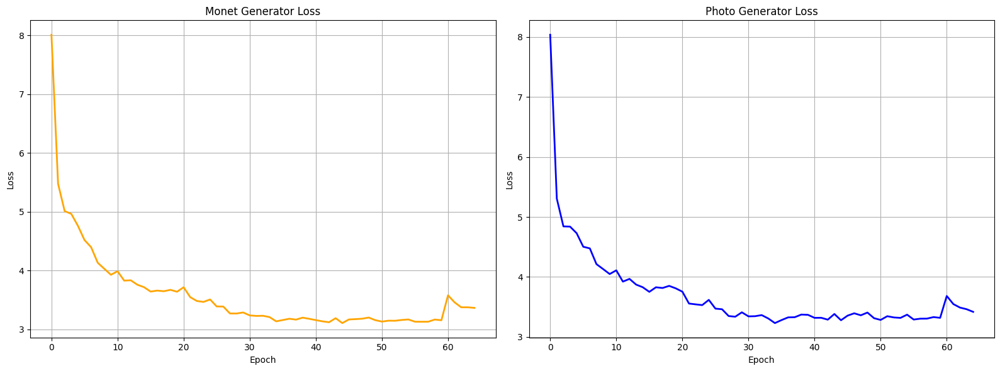

In [15]:
def plot_generator_loss(history):
    plt.figure(figsize=(16, 6))

    epochs = range(len(history['monet_gen_loss']))
    xticks = list(range(0, len(epochs), 2))
    if (len(epochs) - 1) not in xticks:
        xticks.append(len(epochs))

    plt.subplot(1, 2, 1)
    plt.plot(epochs, history['monet_gen_loss'], label='Monet Generator Loss', color='orange', linewidth=2)
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Monet Generator Loss')
    plt.grid(True)

    plt.subplot(1, 2, 2)
    plt.plot(epochs, history['photo_gen_loss'], label='Photo Generator Loss', color='blue', linewidth=2)
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Photo Generator Loss')
    plt.grid(True)

    plt.tight_layout()
    plt.show()

plot_generator_loss(history)

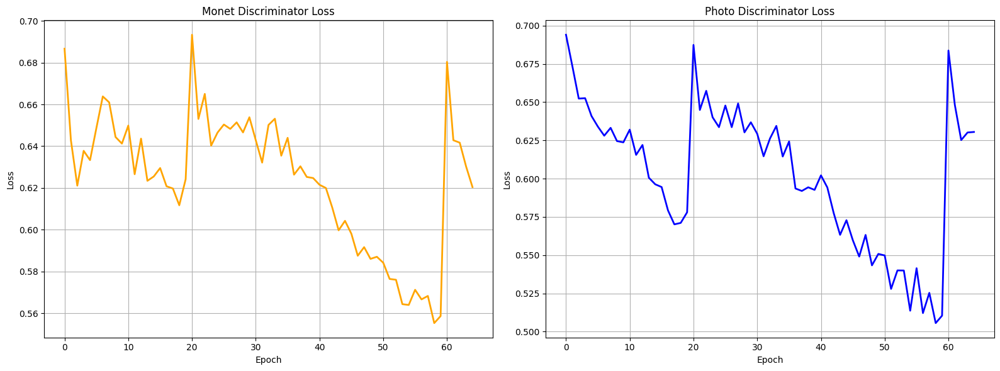

In [16]:
def plot_discriminator_loss(history):
    plt.figure(figsize=(16, 6))

    epochs = range(len(history['monet_disc_loss']))
    xticks = list(range(0, len(epochs), 2))
    if (len(epochs) - 1) not in xticks:
        xticks.append(len(epochs))

    plt.subplot(1, 2, 1)
    plt.plot(history['monet_disc_loss'], label='Monet Discriminator Loss', color='orange', linewidth=2)
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Monet Discriminator Loss')
    plt.grid(True)

    plt.subplot(1, 2, 2)
    plt.plot(history['photo_disc_loss'], label='Photo Discriminator Loss', color='blue', linewidth=2)
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Photo Discriminator Loss')
    plt.grid(True)

    plt.tight_layout()
    plt.show()

plot_discriminator_loss(history)

In [26]:
def display_generated_photo(photo_dataset, num_images=5, start_from=1):
    plt.figure(figsize=(20, 10))
    ssim_scores = []
    selected_photos = photo_dataset.skip(start_from - 1).take(num_images)

    for i, photo in enumerate(selected_photos):
        fake_monet = monet_generator(photo, training=False)
        fake_monet_rescaled = (fake_monet[0] * 0.5 + 0.5).numpy()
        photo_rescaled = (photo[0] * 0.5 + 0.5).numpy()
        ssim_score = tf.image.ssim(photo_rescaled, fake_monet_rescaled, max_val=1.0).numpy()
        ssim_percent = ssim_score * 100
        ssim_scores.append(ssim_percent)

        plt.subplot(2, num_images, i + 1)
        plt.imshow(photo_rescaled)
        plt.title(f"Original Photo", fontsize=20)
        plt.axis('off')

        plt.subplot(2, num_images, i + 1 + num_images)
        plt.imshow(fake_monet_rescaled)
        plt.title(f"Monet Style\nSSIM : {ssim_percent:.3f}%", fontsize=18)
        plt.axis('off')

    plt.tight_layout(rect=[0, 0.03, 1, 1])
    plt.show()

    return ssim_scores 

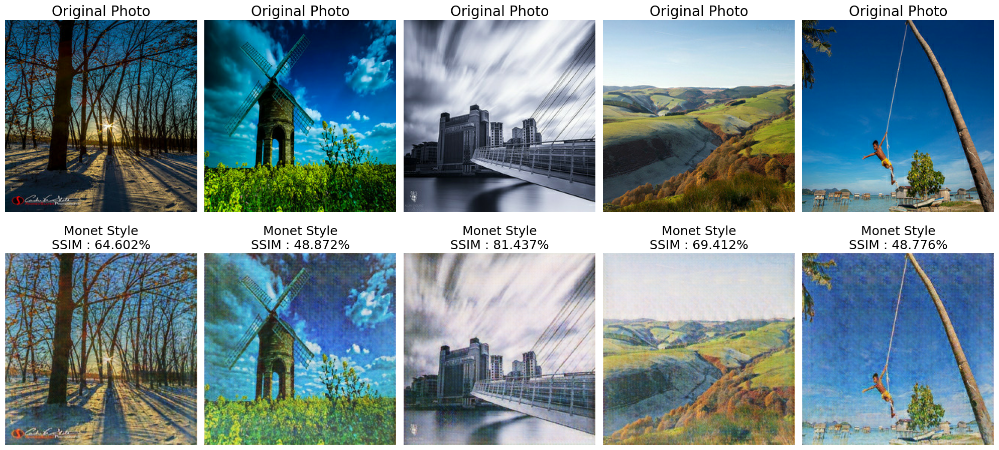

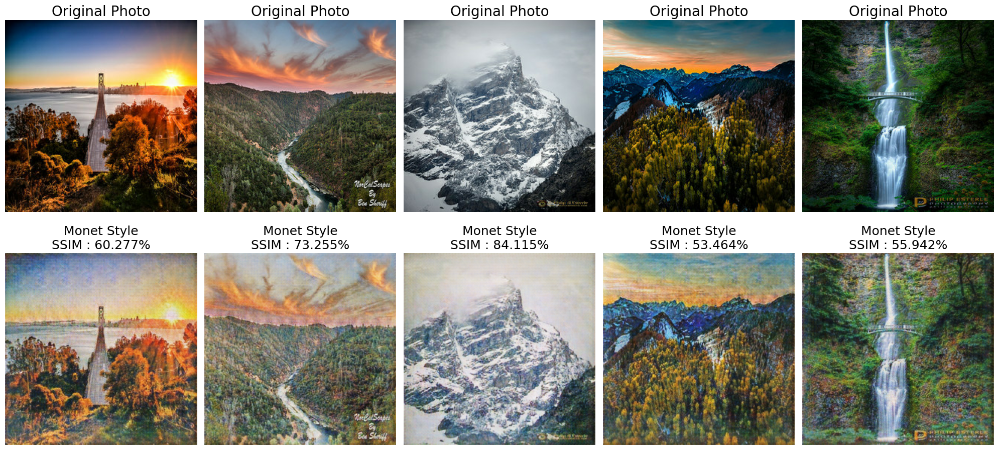

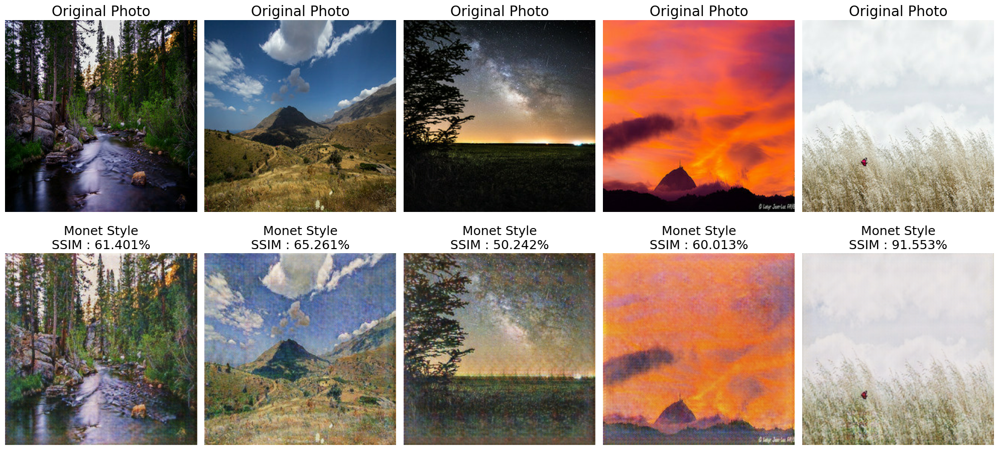

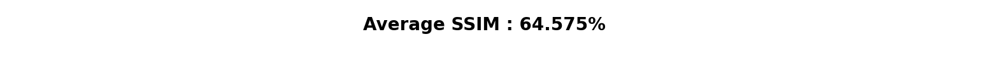

In [29]:
ssim_1 = display_generated_photo(photo_dataset, num_images=5, start_from=1)
print(" " * 100)
ssim_2 = display_generated_photo(photo_dataset, num_images=5, start_from=6)
print(" " * 100)
ssim_3 = display_generated_photo(photo_dataset, num_images=5, start_from=11)
print(" " * 100)

all_ssim = ssim_1 + ssim_2 + ssim_3
avg_ssim_all = sum(all_ssim) / len(all_ssim)
plt.figure(figsize=(20, 1))
plt.axis('off')
plt.figtext(0.5, 0.5, f"Average SSIM : {avg_ssim_all:.3f}%", ha='center', fontsize=20, fontweight='bold')
plt.show()

In [30]:
def display_generated_monet(monet_dataset, num_images=5, start_from=1):
    plt.figure(figsize=(20, 10))
    ssim_scores = []
    selected_monets = monet_dataset.skip(start_from - 1).take(num_images)

    for i, monet in enumerate(selected_monets):
        fake_photo = photo_generator(monet, training=False)
        fake_photo_rescaled = (fake_photo[0] * 0.5 + 0.5).numpy()
        monet_rescaled = (monet[0] * 0.5 + 0.5).numpy()
        ssim_score = tf.image.ssim(monet_rescaled, fake_photo_rescaled, max_val=1.0).numpy()
        ssim_percent = ssim_score * 100
        ssim_scores.append(ssim_percent)

        plt.subplot(2, num_images, i + 1)
        plt.imshow(monet_rescaled)
        plt.title("Original Monet", fontsize=20)
        plt.axis('off')

        plt.subplot(2, num_images, i + 1 + num_images)
        plt.imshow(fake_photo_rescaled)
        plt.title(f"Photo Style\nSSIM : {ssim_percent:.3f}%", fontsize=18)
        plt.axis('off')

    plt.tight_layout(rect=[0, 0.03, 1, 1])
    plt.show()

    return ssim_scores

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.07803416..1.0510834].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.022189736..1.0243263].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.019150019..0.8740964].


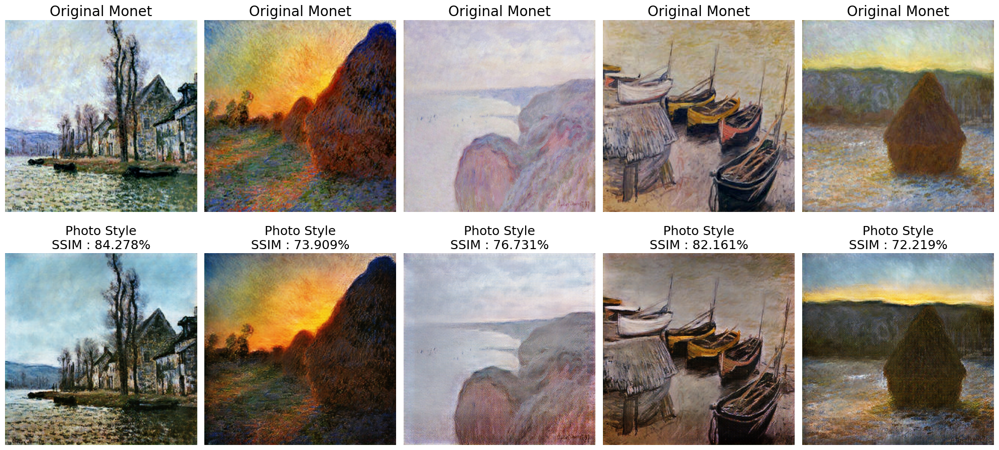

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.00443244..0.9763647].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.059771836..1.0974952].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.06883603..1.0459127].


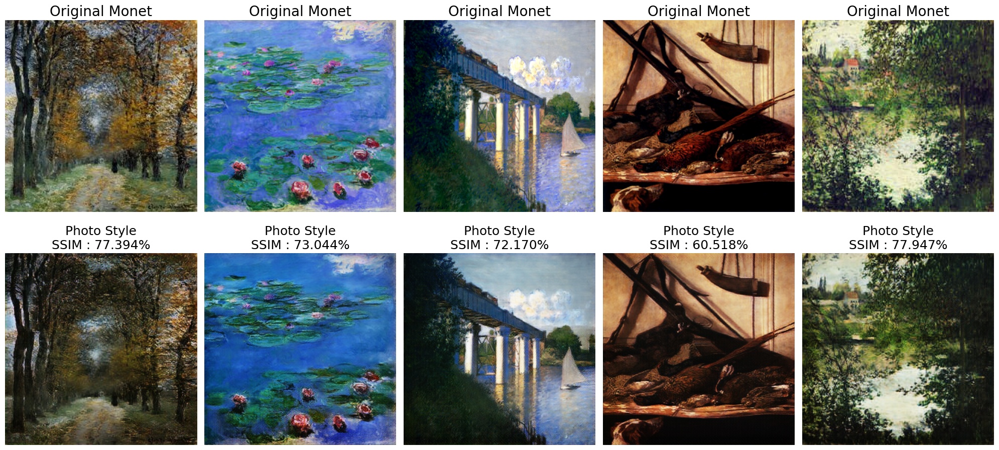

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.08509302..0.9788823].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.033708274..1.0310732].


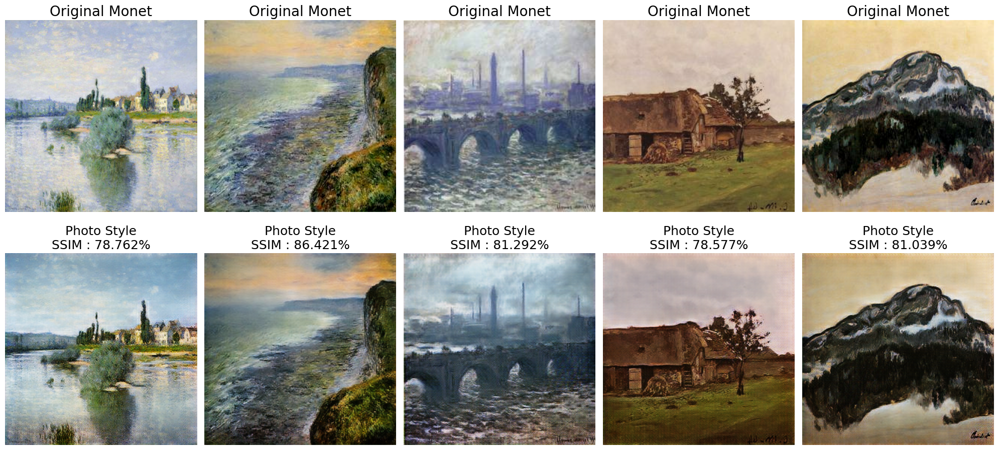

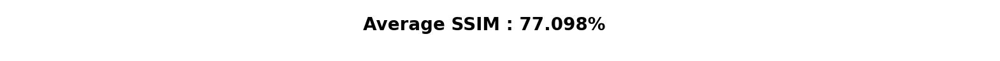

In [31]:
ssim_1 = display_generated_monet(monet_dataset, num_images=5, start_from=1)
print(" " * 100)
ssim_2 = display_generated_monet(monet_dataset, num_images=5, start_from=6)
print(" " * 100)
ssim_3 = display_generated_monet(monet_dataset, num_images=5, start_from=11)
print(" " * 100)

all_ssim = ssim_1 + ssim_2 + ssim_3
avg_ssim_all = sum(all_ssim) / len(all_ssim)
plt.figure(figsize=(20, 1))
plt.axis('off')
plt.figtext(0.5, 0.5, f"Average SSIM : {avg_ssim_all:.3f}%", ha='center', fontsize=20, fontweight='bold')
plt.show()

In [22]:
monet_generator.save("monet_generator_model.h5")
photo_generator.save("photo_generator_model.h5")